In [1]:
import torch
from diffusers import AutoPipelineForImage2Image
from diffusers.utils import load_image, make_image_grid
import numpy as np
from PIL import Image
import os
import glob
import cv2
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import random

c:\Users\Will Poulett\OneDrive - NHS\Documents\AIQCOP\embedding_exploration_tool\.env\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
c:\Users\Will Poulett\OneDrive - NHS\Documents\AIQCOP\embedding_exploration_tool\.env\Lib\site-packages\diffusers\models\transformers\transformer_2d.py:34: FutureWarning: `Transformer2DModelOutput` is deprecated and will be removed in version 1.0.0. Importing `Transformer2DModelOutput` from `diffusers.models.transformer_2d` is deprecated and this will be removed in a future version. Please use `from diffusers.models.modeling_outputs import Transformer2DModelOutput`, instead.
  deprecate("Transformer2DModelOutput", "1.0.0", deprecation_message)


In [2]:
pipeline = AutoPipelineForImage2Image.from_pretrained(
    "runwayml/stable-diffusion-v1-5", variant="fp16", torch_dtype=torch.bfloat16, use_safetensors=True
).to("cuda")

# Run the attention ops without SDPA.
pipeline.unet.set_default_attn_processor()
pipeline.vae.set_default_attn_processor()

Loading pipeline components...: 100%|██████████| 7/7 [00:05<00:00,  1.36it/s]


In [3]:
# dir_path points towards where to find the image dataset
dir_path_train = "model/data/training_set/training_set"
dir_path_test = "model/data/test_set/test_set"
IMAGE_SHAPE = (224, 224)

# This is a good sample as it gives a good mix of val data
random_sample = 1

In [6]:
# Read the folders folders
directories_train, directories_test = os.listdir(dir_path_train), os.listdir(dir_path_train)

files_train, files_test = [], []
labels_train, labels_test = [], []

for folder in directories_train:
    
    fileList = glob.glob(f'{dir_path_train}/{folder}/*')
    labels_train.extend([folder for _ in fileList])
    files_train.extend(fileList)

for folder in directories_test:
    
    fileList = glob.glob(f'{dir_path_test}/{folder}/*')
    labels_test.extend([folder for _ in fileList])
    files_test.extend(fileList)

len(files_train), len(labels_train), len(files_test), len(labels_test)

FileNotFoundError: [WinError 3] The system cannot find the path specified: 'model/data/training_set/training_set'

In [15]:
images_train, images_test = [], []

for path in files_train:
    img_arr = cv2.imread(path)
    img_arr = cv2.cvtColor(img_arr, cv2.COLOR_BGR2RGB)
    resized_arr = cv2.resize(img_arr, (360,360)) # Reshaping images to preferred size
    images_train.append(resized_arr)

for path in files_test:
    img_arr = cv2.imread(path)
    img_arr = cv2.cvtColor(img_arr, cv2.COLOR_BGR2RGB)
    resized_arr = cv2.resize(img_arr, (360,360)) # Reshaping images to preferred size
    images_test.append(resized_arr)
    

In [16]:
x_train, x_val, y_train, y_val = train_test_split(images_train, labels_train, test_size=.1, random_state = random_sample)
x_test_A, x_test_B, y_test_A, y_test_B = train_test_split(images_test, labels_test, test_size = .2, random_state=random_sample)

In [46]:
mixup_images = []

cats = [im for im, label in zip(x_test_B, y_test_B) if label == "cats"]
dogs = [im for im, label in zip(x_test_B, y_test_B) if label == "dogs"]

for i in range(50):
    mix = 0.5 * np.array(dogs[i]) + 0.5 * np.array(cats[i])

    mixup_images.append(Image.fromarray(mix.astype(np.uint8)))

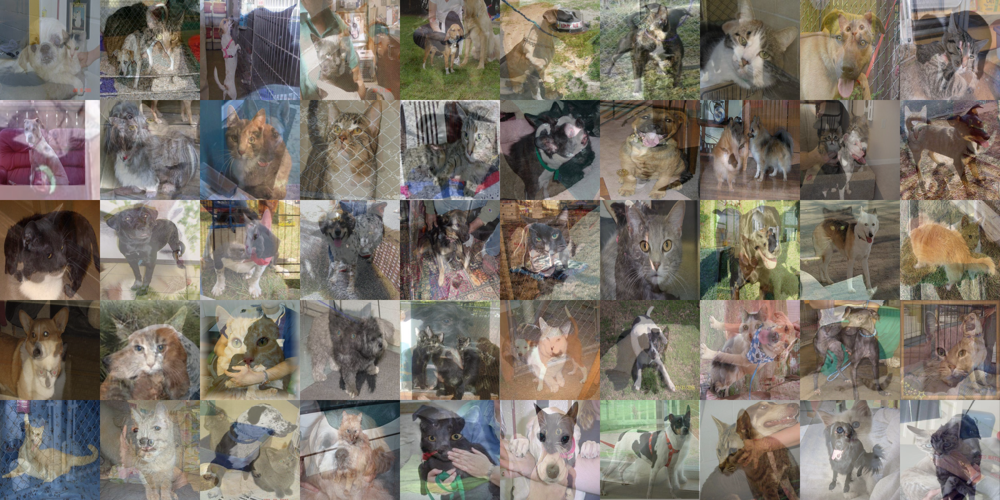

In [47]:
make_image_grid(mixup_images, 5,10)

In [87]:
prompt = "Photograph of pet. The pet is a mixture of features and body parts from both cats and dogs, detailed, 8k."
negative_prompt = "ugly, poor details, bad anatomy, cartoon, diagram, object, over exposed"

In [49]:
strength =  0.7
# strength is one of the most important parameters to consider and it’ll have a huge impact on your generated image.
# It determines how much the generated image resembles the initial image.
guidance_scale = 10
# The guidance_scale parameter is used to control how closely aligned the generated image and text prompt are

In [99]:
dog_i = random.randint(0, len(dogs)-1)
cat_i = random.randint(0, len(cats)-1)

mix = 0.5 * np.array(dogs[dog_i]) + 0.5 * np.array(cats[cat_i])
    
# # Step 1: Compute min and max values
# min_val = np.min(mix)
# max_val = np.max(mix)

# # Step 2: Scale the array to 0-255
# mix = ((mix - min_val) / (max_val - min_val)) * 255

mixup_image = mix

images = pipeline(prompt,
                    num_images_per_prompt = 2,
                    negative_prompt = negative_prompt,
                    image=mixup_image,
                    strength = strength,
                    guidance_scale = guidance_scale).images

100%|██████████| 35/35 [00:08<00:00,  4.20it/s]


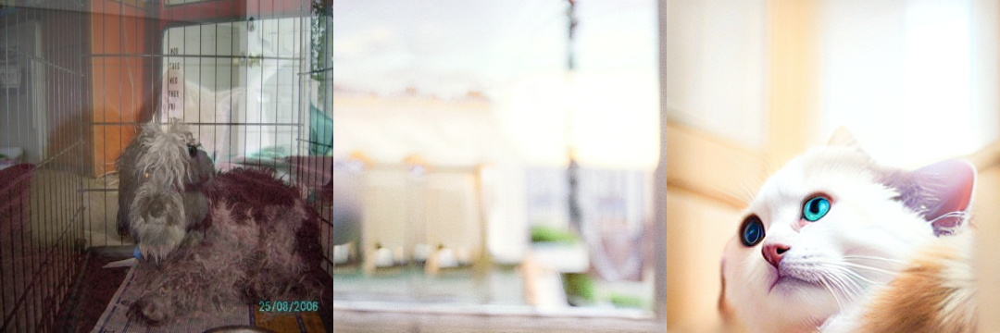

In [100]:
make_image_grid([Image.fromarray(mix.astype(np.uint8))] + images, rows=1, cols=3)

In [94]:
i = 0
cv2.imwrite("all_images/edge_case_images/hybrid_29.jpg", np.array(images[i]))

True

28


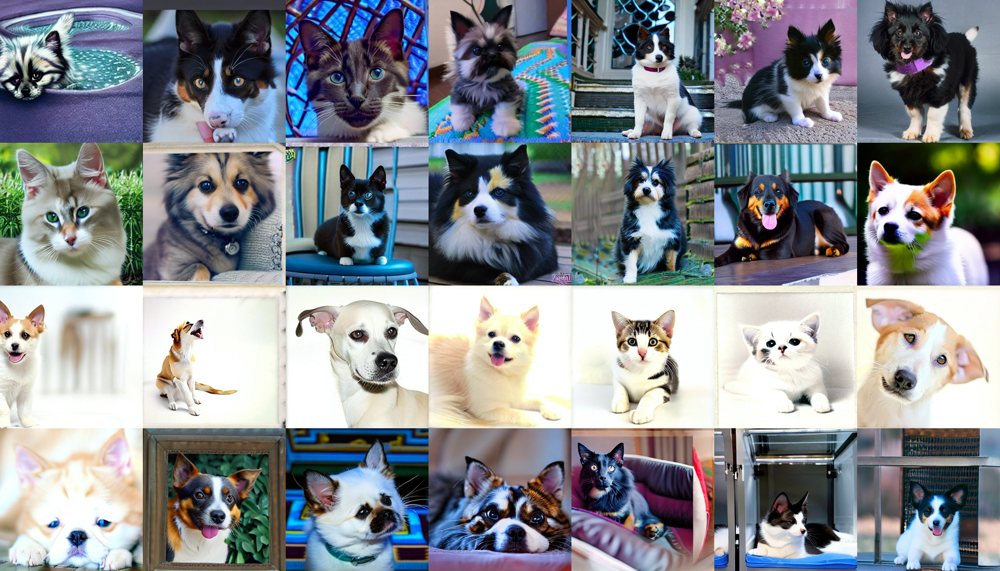

In [105]:
edge_case_images = []

fileList = glob.glob(f'all_images/edge_case_images/*')

for file in fileList:
    im = cv2.imread(file)
    im = cv2.resize(im, (360,360))
    im = Image.fromarray(im.astype(np.uint8))
    edge_case_images.append(im)

print(len(edge_case_images))

make_image_grid(edge_case_images, rows=4, cols=7)

In [106]:
edge_case_images = []

fileList = glob.glob(f'dalle3_images/*')

for file in fileList:
    im = cv2.imread(file)
    im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
    im = cv2.resize(im, (360,360))
    im = Image.fromarray(im.astype(np.uint8))
    edge_case_images.append(im)

make_image_grid(edge_case_images, rows=3, cols=7)

AssertionError: 